<a href="https://colab.research.google.com/github/feonasanofer/CE880_CaseStudy/blob/main/Fetalhealth.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# importing the required libraries for analysis
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# loading the Cardiotocography_data using pandas library
Cardiotocography_data = pd.read_csv('fetal_health.csv')

In [ ]:
Cardiotocography_data.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0


In [ ]:
# counting the null values in the given dataset
Cardiotocography_data.isnull().sum()

baseline value                                            0
accelerations                                             0
fetal_movement                                            0
uterine_contractions                                      0
light_decelerations                                       0
severe_decelerations                                      0
prolongued_decelerations                                  0
abnormal_short_term_variability                           0
mean_value_of_short_term_variability                      0
percentage_of_time_with_abnormal_long_term_variability    0
mean_value_of_long_term_variability                       0
histogram_width                                           0
histogram_min                                             0
histogram_max                                             0
histogram_number_of_peaks                                 0
histogram_number_of_zeroes                                0
histogram_mode                          

In [ ]:
# shape of the Cardiotocography_data
Cardiotocography_data.shape

(2126, 22)

baseline value                                                AxesSubplot(0.125,0.71587;0.110714x0.16413)
accelerations                                              AxesSubplot(0.257857,0.71587;0.110714x0.16413)
fetal_movement                                             AxesSubplot(0.390714,0.71587;0.110714x0.16413)
uterine_contractions                                       AxesSubplot(0.523571,0.71587;0.110714x0.16413)
light_decelerations                                        AxesSubplot(0.656429,0.71587;0.110714x0.16413)
severe_decelerations                                       AxesSubplot(0.789286,0.71587;0.110714x0.16413)
prolongued_decelerations                                     AxesSubplot(0.125,0.518913;0.110714x0.16413)
abnormal_short_term_variability                           AxesSubplot(0.257857,0.518913;0.110714x0.16413)
mean_value_of_short_term_variability                      AxesSubplot(0.390714,0.518913;0.110714x0.16413)
percentage_of_time_with_abnormal_long_term_var

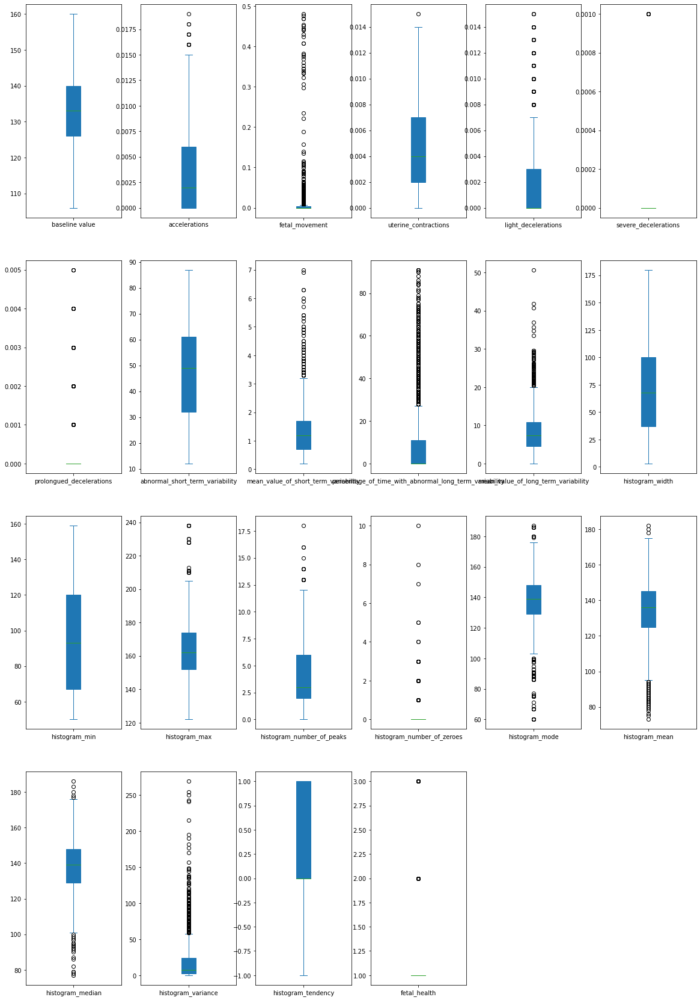

In [ ]:
# outliers present in the dataset
Cardiotocography_data.plot(subplots = True, kind = 'box', layout = (4,6), patch_artist = True, figsize = (20,30))

# calculating the correlational data

In [ ]:
coorelational_data = Cardiotocography_data.corr()

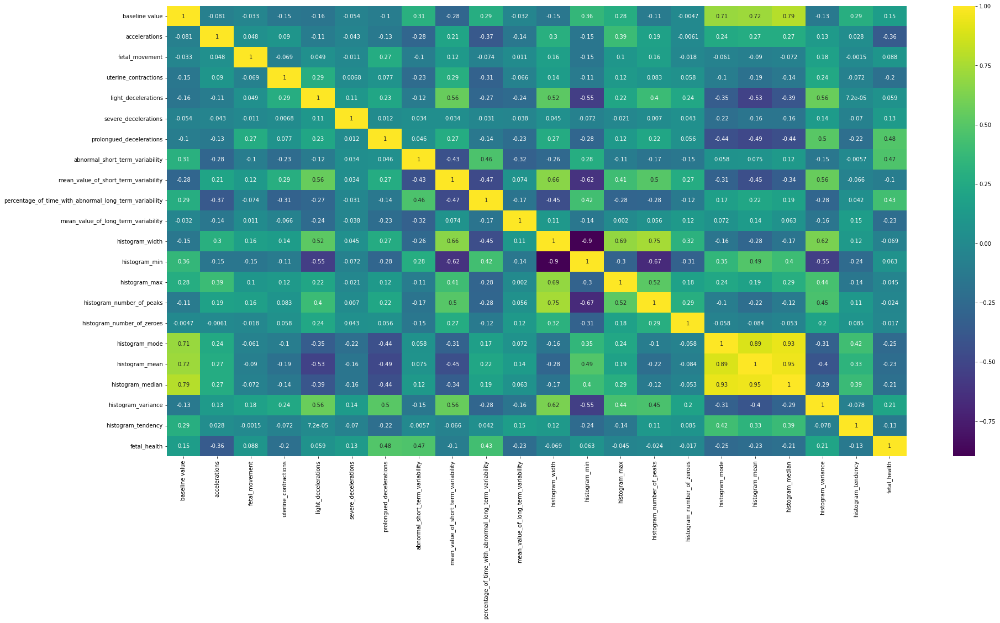

In [ ]:
plt.figure(figsize = (30, 15))
sns.heatmap(coorelational_data, annot = True, cmap = 'viridis')

In [ ]:
# feature value selection
features = Cardiotocography_data[['histogram_median', 'histogram_variance', 'histogram_tendency', 'histogram_mode', 'histogram_mean',
                           'histogram_min', 'histogram_max', 'histogram_number_of_peaks', 'baseline value', 'accelerations',
                           'uterine_contractions', 'light_decelerations']]
targets = Cardiotocography_data['fetal_health']

In [ ]:
from sklearn.model_selection import train_test_split
first_set_of_training, first_set_of_testing, second_set_of_training, second_set_of_testing = train_test_split(features, targets, test_size = 0.25)

# SVM Model

In [ ]:
from sklearn.svm import SVC
support_vector_machine = SVC(kernel='rbf', random_state = 1)
support_vector_machine.fit(first_set_of_training, second_set_of_training)

SVC(random_state=1)

In [ ]:
svm_pred = support_vector_machine.predict(first_set_of_testing)

# KNN Model

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
neighbouring_model = KNeighborsClassifier(n_neighbors=5)
neighbouring_model.fit(first_set_of_training, second_set_of_training)

KNeighborsClassifier()

In [ ]:
knn_pred = neighbouring_model.predict(first_set_of_testing)

# Random Forest Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier
forest = RandomForestClassifier()

In [ ]:
forest.fit(first_set_of_training, second_set_of_training)
random_pred = forest.predict(first_set_of_testing)

# Decision Tree Model

In [ ]:
from sklearn.tree import DecisionTreeClassifier
tree = DecisionTreeClassifier()

In [ ]:
tree.fit(first_set_of_training, second_set_of_training)
decision_pred = tree.predict(first_set_of_testing)

# Model Results

In [ ]:
# svm model results
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
print('accuracy: ', accuracy_score(svm_pred, second_set_of_testing))
print('classification report \n', classification_report(svm_pred, second_set_of_testing))
print('\n confusion matrix', confusion_matrix(svm_pred, second_set_of_testing))

accuracy:  0.7875939849624061
classification report 
               precision    recall  f1-score   support

         1.0       1.00      0.78      0.88       510
         2.0       0.00      0.00      0.00         0
         3.0       0.39      0.95      0.55        22

    accuracy                           0.79       532
   macro avg       0.46      0.58      0.48       532
weighted avg       0.97      0.79      0.86       532


 confusion matrix [[398  79  33]
 [  0   0   0]
 [  1   0  21]]


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
print('accuracy: ', accuracy_score(decision_pred, second_set_of_testing))
print('classification report \n', classification_report(decision_pred, second_set_of_testing))
print('\n confusion matrix', confusion_matrix(decision_pred, second_set_of_testing))

accuracy:  0.8590225563909775
classification report 
               precision    recall  f1-score   support

         1.0       0.95      0.90      0.93       418
         2.0       0.53      0.59      0.56        71
         3.0       0.69      0.86      0.76        43

    accuracy                           0.86       532
   macro avg       0.72      0.79      0.75       532
weighted avg       0.87      0.86      0.86       532


 confusion matrix [[378  34   6]
 [ 18  42  11]
 [  3   3  37]]


In [ ]:
print('accuracy: ', accuracy_score(knn_pred, second_set_of_testing))
print('classification report \n', classification_report(knn_pred, second_set_of_testing))
print('\n confusion matrix', confusion_matrix(knn_pred, second_set_of_testing))

accuracy:  0.8214285714285714
classification report 
               precision    recall  f1-score   support

         1.0       0.94      0.86      0.90       439
         2.0       0.32      0.45      0.37        55
         3.0       0.67      0.95      0.78        38

    accuracy                           0.82       532
   macro avg       0.64      0.75      0.68       532
weighted avg       0.86      0.82      0.83       532


 confusion matrix [[376  53  10]
 [ 22  25   8]
 [  1   1  36]]


In [ ]:
print('accuracy: ', accuracy_score(random_pred, second_set_of_testing))
print('classification report \n', classification_report(random_pred, second_set_of_testing))
print('\n confusion matrix', confusion_matrix(random_pred, second_set_of_testing))

accuracy:  0.8778195488721805
classification report 
               precision    recall  f1-score   support

         1.0       0.97      0.90      0.93       430
         2.0       0.53      0.69      0.60        61
         3.0       0.70      0.93      0.80        41

    accuracy                           0.88       532
   macro avg       0.74      0.84      0.78       532
weighted avg       0.90      0.88      0.89       532


 confusion matrix [[387  36   7]
 [ 10  42   9]
 [  2   1  38]]


# Exploratory Analysis

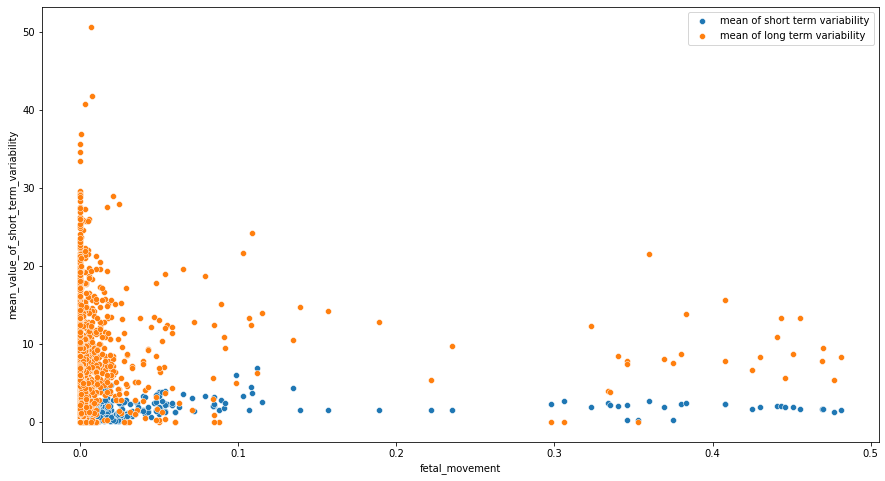

In [ ]:
# plotting between mean_value_of_short_term_variability and mean_value_of_long_term_variability
plt.figure(figsize = (15, 8))
sns.scatterplot(data = Cardiotocography_data, y = 'mean_value_of_short_term_variability', x = 'fetal_movement')
sns.scatterplot(data = Cardiotocography_data, y = 'mean_value_of_long_term_variability', x = 'fetal_movement')
plt.legend(['mean of short term variability', 'mean of long term variability'])

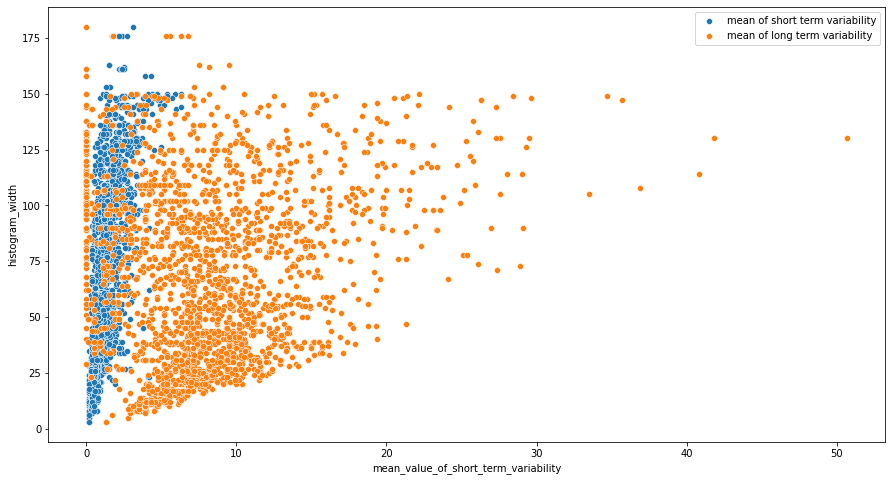

In [ ]:
plt.figure(figsize = (15, 8))
sns.scatterplot(data = Cardiotocography_data, x = 'mean_value_of_short_term_variability', y = 'histogram_width')
sns.scatterplot(data = Cardiotocography_data, x = 'mean_value_of_long_term_variability', y = 'histogram_width')
plt.legend(['mean of short term variability', 'mean of long term variability'])

In [ ]:
! pip install AutoViz

     |████████████████████████████████| 59 kB 4.3 MB/s 
     |████████████████████████████████| 175 kB 18.1 MB/s 
     |████████████████████████████████| 3.1 MB 49.4 MB/s 
     |████████████████████████████████| 136 kB 59.4 MB/s 
     |████████████████████████████████| 12.9 MB 40.2 MB/s 
     |████████████████████████████████| 18.5 MB 757 kB/s 
     |████████████████████████████████| 11.2 MB 46.1 MB/s 
     |████████████████████████████████| 899 kB 36.0 MB/s 
  Created wheel for emoji: filename=emoji-1.7.0-py3-none-any.whl size=171046 sha256=27f33d3b56e1870b33d215e8b8f6f8020a984e80cfa60fcc835be543d113e6ca
  Stored in directory: /root/.cache/pip/wheels/8a/4e/b6/57b01db010d17ef6ea9b40300af725ef3e210cb1acfb7ac8b6
Successfully built emoji
  Attempting uninstall: typing-extensions
    Found existing installation: typing-extensions 3.10.0.2
    Uninstalling typing-extensions-3.10.0.2:
      Successfully uninstalled typing-extensions-3.10.0.2
  Attempting uninstall: bokeh
    Found existing i

Alert! from version 0.1.38. After importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
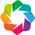

In [ ]:
#importing Autoviz class
from autoviz.AutoViz_Class import AutoViz_Class#Instantiate the AutoViz class
AV = AutoViz_Class()

Shape of your Data Set loaded: (2126, 22)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    22 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
Number of All Scatter Plots = 231
No categorical or numeric vars in data set. Hence no bar charts.
Time to run AutoViz = 56 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


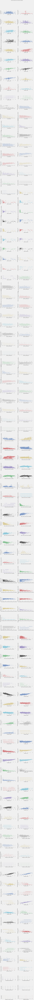

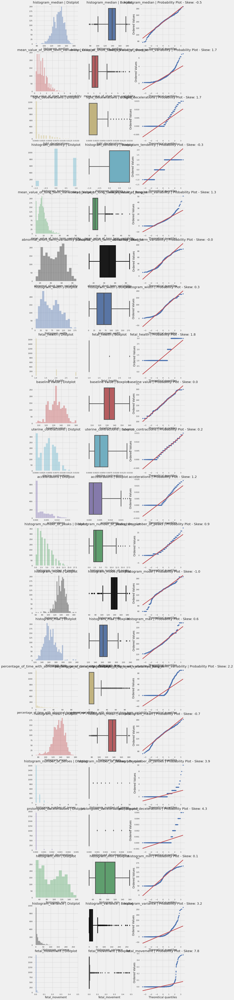

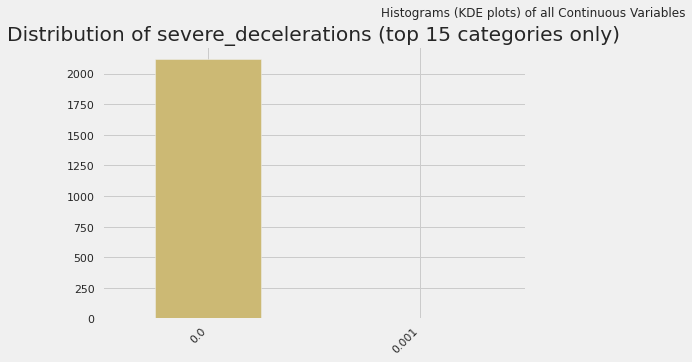

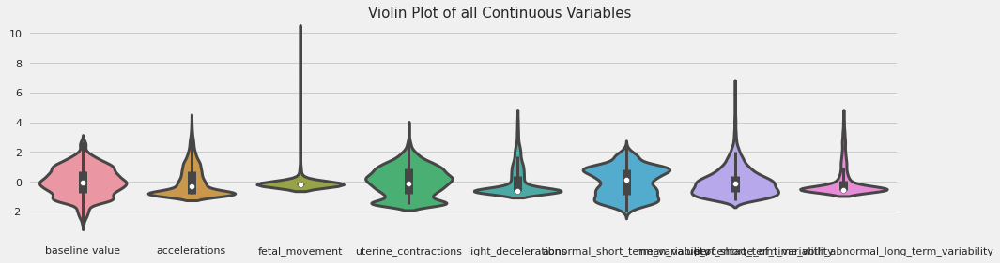

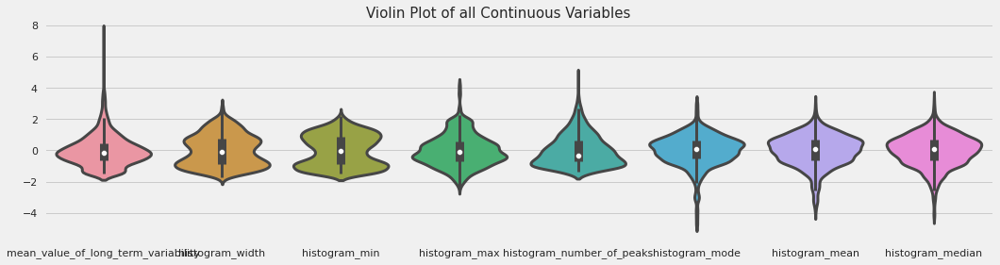

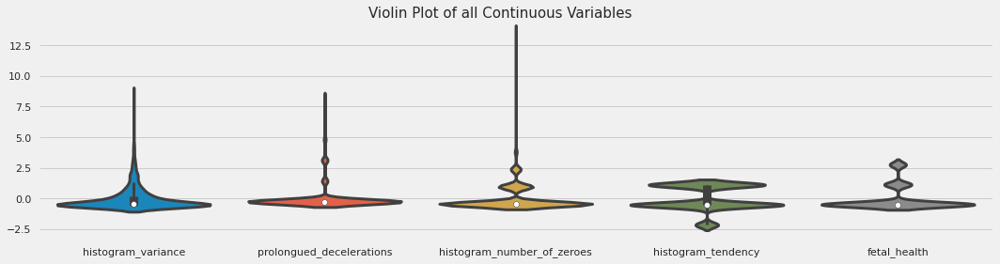

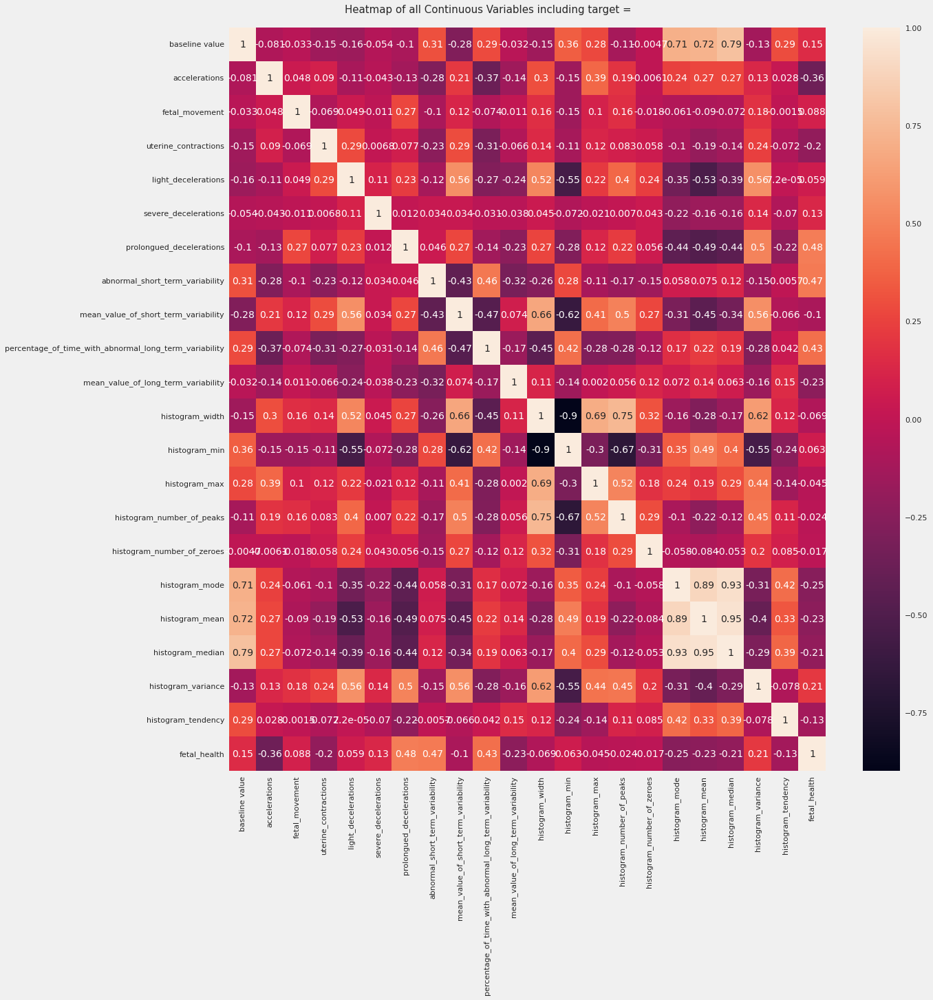

In [ ]:
df = AV.AutoViz('fetal_health.csv')

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


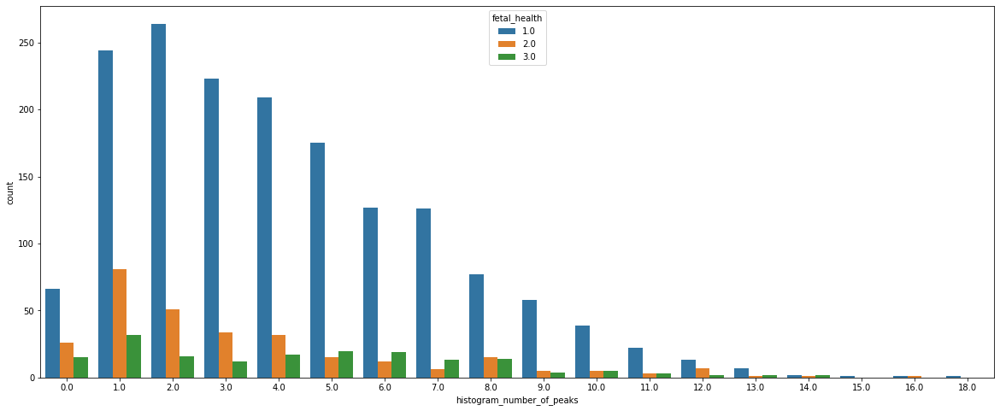

In [ ]:
# counting the fatel health attribute
plt.figure(figsize = (20,8))
sns.countplot(Cardiotocography_data['histogram_number_of_peaks'], hue = Cardiotocography_data['fetal_health'])

# Descriptive Analysis

In [ ]:
# description of data
Cardiotocography_data.describe().T

,count,mean,std,min,25%,50%,75%,max
baseline value,2126.0,133.303857,9.840844,106.0,126.000,133.000,140.000,160.000
accelerations,2126.0,0.003178,0.003866,0.0,0.000,0.002,0.006,0.019
fetal_movement,2126.0,0.009481,0.046666,0.0,0.000,0.000,0.003,0.481
uterine_contractions,2126.0,0.004366,0.002946,0.0,0.002,0.004,0.007,0.015
light_decelerations,2126.0,0.001889,0.002960,0.0,0.000,0.000,0.003,0.015
severe_decelerations,2126.0,0.000003,0.000057,0.0,0.000,0.000,0.000,0.001
prolongued_decelerations,2126.0,0.000159,0.000590,0.0,0.000,0.000,0.000,0.005
abnormal_short_term_variability,2126.0,46.990122,17.192814,12.0,32.000,49.000,61.000,87.000
mean_value_of_short_term_variability,2126.0,1.332785,0.883241,0.2,0.700,1.200,1.700,7.000
percentage_of_time_with_abnormal_long_term_variability,2126.0,9.846660,18.396880,0.0,0.000,0.000,11.000,91.000


In [ ]:
# data types if each column
Cardiotocography_data.dtypes

baseline value                                            float64
accelerations                                             float64
fetal_movement                                            float64
uterine_contractions                                      float64
light_decelerations                                       float64
severe_decelerations                                      float64
prolongued_decelerations                                  float64
abnormal_short_term_variability                           float64
mean_value_of_short_term_variability                      float64
percentage_of_time_with_abnormal_long_term_variability    float64
mean_value_of_long_term_variability                       float64
histogram_width                                           float64
histogram_min                                             float64
histogram_max                                             float64
histogram_number_of_peaks                                 float64
histogram_